In [1]:
import scanpy as sc
import matplotlib as plt
import pandas as pd
import numpy as np
import os
from scipy.sparse import csr_matrix
import seaborn as sns

import warnings

warnings.filterwarnings("ignore", category=DeprecationWarning)

sc.settings.verbosity = 0
sc.settings.set_figure_params(dpi=80, facecolor="white", frameon=False)

In [2]:
adata2 = sc.read("tsukui_dimensionality_reduced_new_countsraw.h5ad")

## Load data and check if raw counts are included

In [3]:
print(adata2.X.toarray()[:10, :10])

[[0.         0.         0.         0.         0.         0.
  0.         0.         0.         0.        ]
 [0.         0.         0.         0.         0.         0.
  0.         0.         0.         0.7037222 ]
 [0.         0.         0.         0.         0.         0.
  0.         0.         0.82182264 0.        ]
 [0.         0.         0.         0.         0.         0.
  0.49167168 0.         0.49167168 0.        ]
 [0.         0.         0.         0.         0.         0.
  0.         0.         0.         0.7434465 ]
 [0.         0.         0.         0.         0.         0.
  0.         0.         0.         0.        ]
 [0.         0.         0.         0.         1.0116534  0.
  0.         0.         0.         0.        ]
 [0.         0.         0.         0.         0.         0.
  0.         0.         0.8723576  0.8723576 ]
 [0.         0.         0.         0.         0.         0.
  0.         0.         0.         0.        ]
 [0.         0.         0.         0.

In [4]:
adata2.X=adata2.layers['raw_counts']

In [6]:
print(adata2.layers['raw_counts'].toarray())

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 1. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 1. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 2. ... 1. 0. 0.]]


## Neighbors, Umap and Leiden Clustering

In [8]:
sc.pp.neighbors(adata2, n_pcs=30)
sc.tl.umap(adata2)

In [9]:
sc.tl.leiden(adata2)
sc.tl.leiden(adata2, key_added="leiden_res0_25", resolution=0.25)
sc.tl.leiden(adata2, key_added="leiden_res0_5", resolution=0.5)
sc.tl.leiden(adata2, key_added="leiden_res1", resolution=1.0)

/home/sch/schuboea/miniforge3/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/sch/schuboea/miniforge3/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/sch/schuboea/miniforge3/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


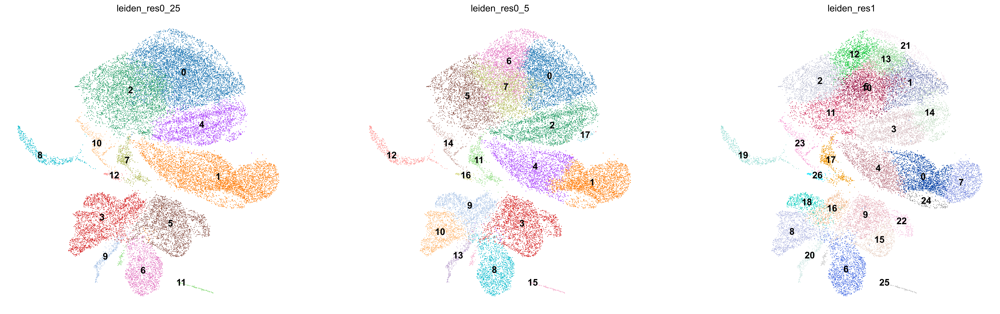

In [10]:
with plt.rc_context({"figure.figsize": (8, 8), "figure.dpi": (300)}):
    sc.pl.umap(
        adata2,
        color=["leiden_res0_25", "leiden_res0_5", "leiden_res1"],
        legend_loc="on data",
    )

Leiden 0.5 seems like a good choice here

## Set marker genes, one from Daniel´s annotation, one from HCLA, one from the original publication and lastly, our consensus markers

In [11]:
marker_genes = {
    'Macrophages':['Apoe', 'Mrc1', 'Marco', 'Mertk'], 
    'Monocytes': ['Cd14', 'Vcan'], 
    'T-Cells': ['Cd3e', 'Cd4','Cd8a', 'Cd3d'],
    'B-Cells':['Cd19', 'Cd79a', 'Ms4a1'],
    'AT2':['Muc1', 'Sftpc', 'Sftpd', 'Lcn2', "Cxcl15"],
    'AT1': ['Vegfa',"Ager", "Pdpn"], 
    'Krt8': ['Krt8'],
    'Endothelial': ['Pecam1', "Ly6c1"],
    'Fibroblasts': ['Col1a2'],
    "Myofibroblasts": ["Cthrc1", "Spp1", "Pdgfra", 
                       "Acta2", "Myh11", "Tagln", "Hhip"]    # xie paper uses also these
}
marker_genes_hcla = {
    'Alveolar Macrophages':["Fabp4","Apoe","Msr1","Serping1","Mcemp1","Trem1","Gpnmb","Cyp27a1","Pparg","Nupr1"], 
    "Interstitial macrophages":["F13a1","Rnase1","Stab1","Rnase6","Gpr183","Fgl2","Csf1r","Fcgr2b","Il13ra1","Metrnl"],
    'Monocytes': ["Vcan","Cfp","Ereg","Cd300e","Fgl2"], # classical
    'T-Cells': ['Cd3e', 'Cd4','Cd8a', 'Cd3d'], # cd4 + cd 8
    'B-Cells':['Ms4a1',"Bank1","Ltb","Mef2c","Birc3","Limd2","Gpr183"], 
    'AT1': ["Ager","Cav1","Myl9","Sfta2", "Clic3", "Spock2", "Anxa3","Rtkn2", "Timp3", "Tnnc1"], # Ager    Cav1   Myl9        SFTA2        CliC3        Spock2        Anxa3        Rtkn2        Timp3        Tnnc1
    'AT2':['Sftpc', 'Sftpd', "Cxcl15", "Sfta2", "Lamp3", "Lrrk2", "Tfpi", "Mfsd2a"], # Sftpb        SFTPC        SFTPA1        SFTPA2        SFTA2        LAMP3        LRRK2        TFPI        MFSD2A        SERPINA1
   # 'Endothelial': ['Pecam1', "Ly6c1"], # from Daniel's 
   # 'Fibroblasts': ['Col1a2'], # from Daniel's 
    "Myofibroblasts": ["Aspn","Bche","Itgbl1","Myh11"],
    "NK-cells": ["Nkg7","Gzmb","Prf1","Cst7","Klrd1","Ctsw","Cd7","Gzma","Cd247"]
}
markers_tsukui = {
    'Endothelial':["Pecam1","Tek"],
    'Hematopoietic':["Ptprc", "Vav1"],
    'Epithelial':["Epcam", "Cdh1"],
    'T-Cells':["Cd3e"],
    'B-Cells':["Cd19"],
    'Myeloid and macrophage':["Itgax", "Siglecf", "Cd68", "Ccr2"],
    'Neutrophil':["Ly6g"],
    'Mesothelial':["Msln"],
    'Dendritic-Cells':["Cd86","Itgae"],
    'NK-Cells':["Nkg7","Gzmb"],
    'Mesenchymal':["Pdgfra","Tcf21","Cdh11"],
}
finalmarkers = {
  "AT1": ["S100a6", "Ager", "Pdpn", "Vegfa"],
  "AT2": ["Muc1", "Sftpc", "Sftpd", "Cxcl15", "Lcn2"],
  "Transitioning epithelial": ["Krt8", "Krt18"],
  "Epithelial": ["Epcam", "Cdh1"],
  "Alveolar macrophages": ["Marco", "Chil3", "Fabp4", "Siglecf", "Il18", "Ear1", "Fabp1", "Car4", "Ctsk", "Chil3", "S100a1", "Wfdc21", "Itgam", "Cd36", "Gpnmb", "Litaf", "Jund", "Bhlhe40", "Bhlhe41", "Klf9", "Atf3", "Atf4"],
  "Interstitial macrophages": ["Trem2", "C1qa"],
  "Classical monocytes": ["F13a1", "Ly6c2"],
  "Non-classical monocytes": ["Treml4", "Fcgr3"],
  "Dendritic cells": ["Clec9a", "H2-Aa"],
  "Dendritic cells pDC": ["Siglech", "Clec4b1"],#  Clec4b1 instead of Clec4c
  "Dendritic cells Ccr7-hi": ["Ccr7"],
  "CD4 T-cells": ["Cd4", "Cd3e", "Cd3d"],
  "CD8 T-cells": ["Cd8a", "Cd3d"],
  "NK cells": ["Tyrobp", "Gzma", "Nkg7"],
  "B-cells": ["Cd79a", "Cd19", "Ms4a1"],
  "Neutrophils": ["S100a8", "S100a9"],
  "Endothelial": ["Pecam1", "Ly6c1"], # Pecam1 instead of Pecam4
  "Lymphatic endothelial": ["Pdpn"],
  "Aerocytes": ["Car4", "Ednrb"],
  "Pericytes": ["Vtn", "Mcam", "Cspg4"],
  "Lipofibroblasts": ["Plin2", "Lpl", "Tcf21"],
  "Myofibroblasts": ["Cthrc1", "Spp1", "Pdgfra", "Col3a1", "Postn", "Tnc", "S100a6", "Ccl2"],
  "Alveolar fibroblast": ["Npnt", "Ces1d", "Slc7a10"],
  "Adventitial fibroblast": ["Pi16", "Dcn", "Il33", "Ccl11", "Adh7"],
  "Peribronchial fibroblasts": ["Hhip", "Aspn", "Fgf18", "Lgr5", "Lgr6"],
  "SMCs": ["Acta2", "Tagln", "Myh11"]
}

## Check dotplot and umap for final consensus markers

/home/sch/schuboea/miniforge3/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


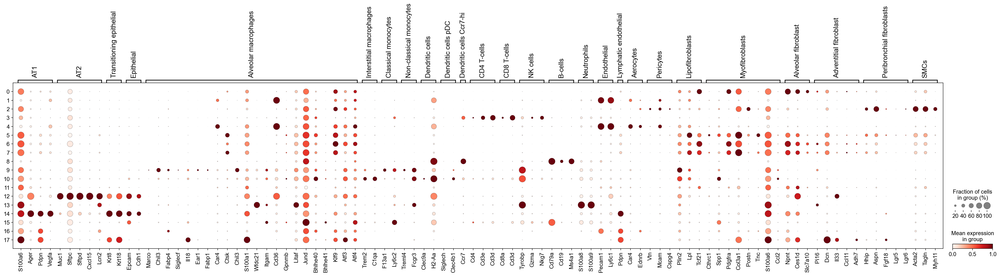

In [12]:
sc.pl.dotplot(adata2, finalmarkers, groupby='leiden_res0_5', standard_scale="var")

In [ ]:
#with plt.rc_context({"figure.figsize": (10, 10), "figure.dpi": (300)}):
# Final Markers
plt.rcParams['figure.figsize'] = (6, 6)
for cell_type in finalmarkers.keys():
    print(cell_type)
    sc.pl.umap(adata2, color=finalmarkers[cell_type], size=15)
sc.tl.leiden(adata2, resolution=0.5, key_added="leiden_0_5")
plt.rcParams['figure.figsize'] = (8, 8)
sc.pl.umap(adata2, color="leiden_0_5", legend_loc="on data")

Umap outputs removed since they are too big :(

## Manual annotation
I kind of messed up here, should have saved it as adata

In [4]:
adata2.write("tsukui_annotation.h5ad")

NameError: name 'adata2' is not defined

In [18]:
dotplot_anno = { 
    "0": "Alveolar fibroblasts", 
    "1": "Endothelial", # 
    "2": "SMCs", 
    "3": "T-cells",
    "4": "Endothelial", 
    "5": "Lipofibroblasts", 
    "6": "Alveolar fibroblasts", 
    "7": "Myofibroblasts", # ?
    "8": "B-cells", #and dendritic
    "9": "NK cells", 
    "10": "Dendritic cells",
    "11": "NA", 
    "12":"AT2",  #all AT1,AT2, transitioning and epithelial
    "13":"Neutrophils", #and some NK
    "14":"Epithelial", #
    "15":"Alveolar macrophages", #
    "16":"NA",
    "17":"AT1", # not so remarkable
    #"18":"Endothelial", #
    #"19":"Adventitial fibroblasts", #
    #"20":"Transitioning epithelial", #
    #"21":"NK cells", #
}

In [14]:
old_dotplot_anno = { 
    "0": "Alveolar fibroblasts", #multiple fibroblast markers
    "1": "Endothelial", # 
    "2": "Myofibroblasts", #multiple fibroblast markers
    "3": "Adventitial fibroblasts",
    "4": "SMCs", # Macrophages ?
    "5": "B-cells", #and some dendritic
    "6": "Peribronchial fibroblasts", 
    "7": "NA", # ?
    "8": "NK cells", 
    "9": "T-cells", 
    "10": "NK cells",
    "11": "Aerocytes", #Alveolar mos, endothelial and aerocytes
    "12":"Epithelial",  #all AT1,AT2, transitioning and epithelial
    "13":"Dendritic cells", #and some NK
    "14":"NA", #
    "15":"Neutrophils", #
    "16":"NA",
    "17":"B-cells", # not so remarkable
    "18":"Endothelial", #
    "19":"Adventitial fibroblasts", #
    "20":"Transitioning epithelial", #
    "21":"NK cells", #
}

## Check dotplot and umap with the final manual annotation

/home/sch/schuboea/miniforge3/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


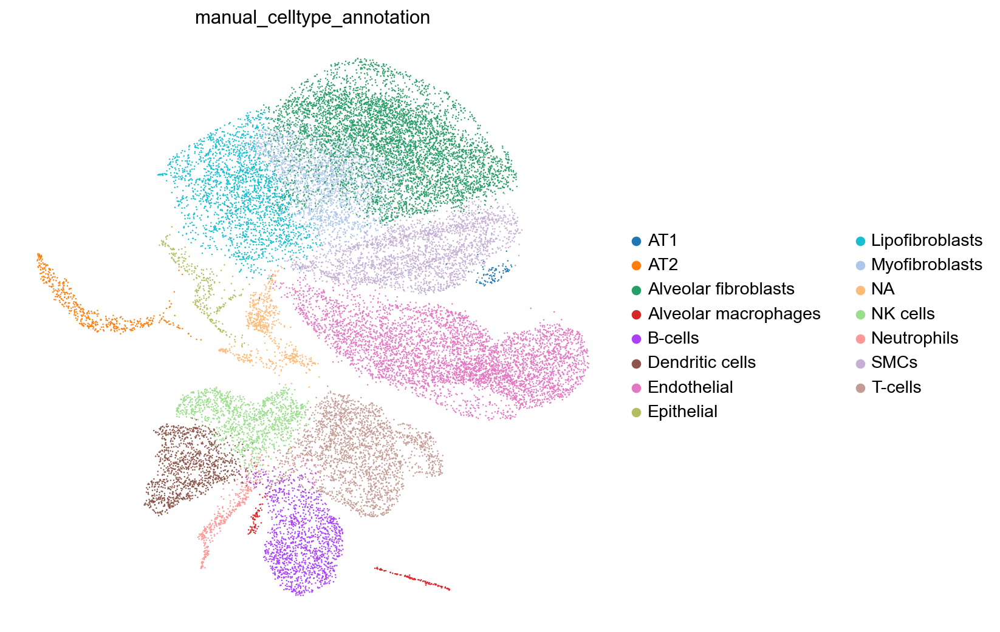

In [19]:
adata2.obs["manual_celltype_annotation"] = adata2.obs.leiden_res0_5.map(dotplot_anno).astype("category")
sc.pl.umap(adata2, color=["manual_celltype_annotation"])

/home/sch/schuboea/miniforge3/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


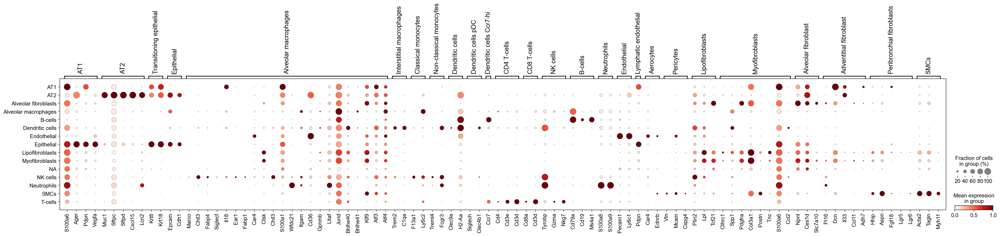

In [20]:
sc.pl.dotplot(adata2, finalmarkers, groupby='manual_celltype_annotation', standard_scale="var")

## Bring Adata object into the right form for merging (delete unnecessary obs)

In [65]:
import anndata as ad
merge_tsukui = ad.AnnData(X=adata2.layers['raw_counts'], obs=adata2.obs[['doublet_score', 'predicted_doublet',
                                                 "manual_celltype_annotation", "batch", "condition"]],
                       var=df)

/home/sch/schuboea/miniforge3/envs/scanpy/lib/python3.9/site-packages/anndata/_core/anndata.py:117: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [86]:
merge_tsukui.var=merge_tsukui.var.set_index(['symbol'])

In [88]:
merge_tsukui.obs

,doublet_score,predicted_doublet,manual_celltype_annotation,batch,condition
AAACCTGCAAGTCTGT-1-0,0.039233,False,NA,0,UT
AAACCTGCAGCTGCTG-1-0,0.003630,False,Aerocytes,0,UT
AAACCTGCATCCGTGG-1-0,0.023072,False,NA,0,UT
AAACCTGCATGCTAGT-1-0,0.011011,False,NK cells,0,UT
AAACCTGGTAGTGAAT-1-0,0.028488,False,Epithelial,0,UT
...,...,...,...,...,...
TTTGTCAGTGTGAATA-1-7,0.026250,False,NK cells,7,UT
TTTGTCATCAACGGCC-1-7,0.011861,False,NK cells,7,UT
TTTGTCATCAATACCG-1-7,0.086782,False,NK cells,7,UT
TTTGTCATCCGCATCT-1-7,0.006733,False,Endothelial,7,UT


In [92]:
merge_tsukui.write("tsukui_mini4merge_overwrite.h5ad")

In [64]:
df = pd.DataFrame(adata2.var.index)
df.set_index(df. iloc[:,0])
#df.drop(columns=df.columns[1], axis=1, inplace=True)

,0
0,
Xkr4,Xkr4
Rp1,Rp1
Sox17,Sox17
Mrpl15,Mrpl15
Lypla1,Lypla1
...,...
AC168977.2,AC168977.2
AC168977.1,AC168977.1
PISD,PISD


Endothelial


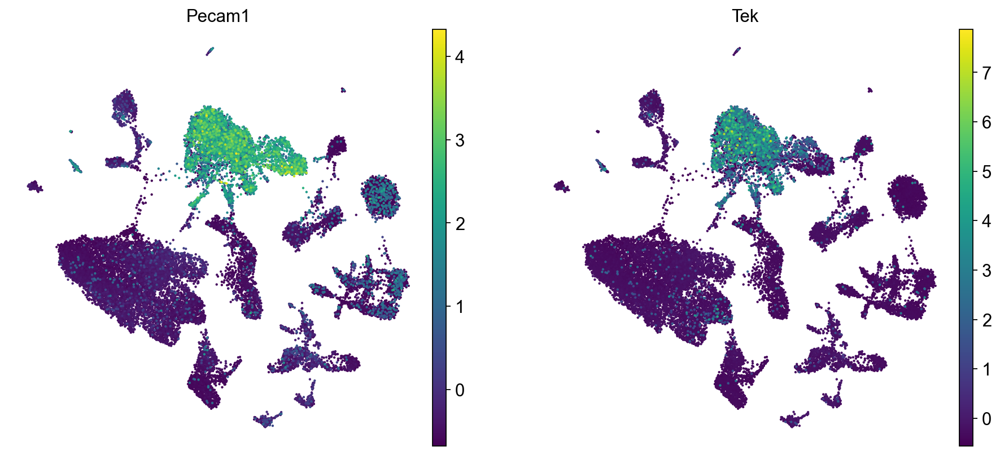

Hematopoietic


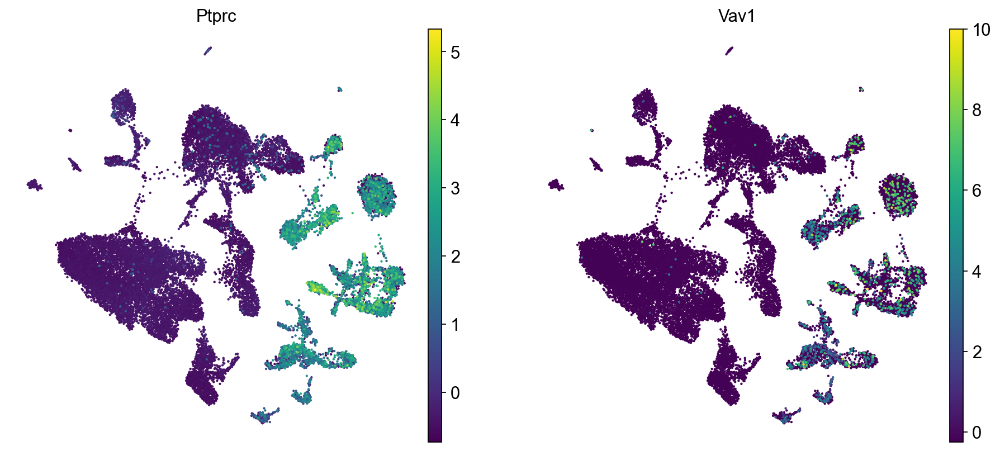

Epithelial


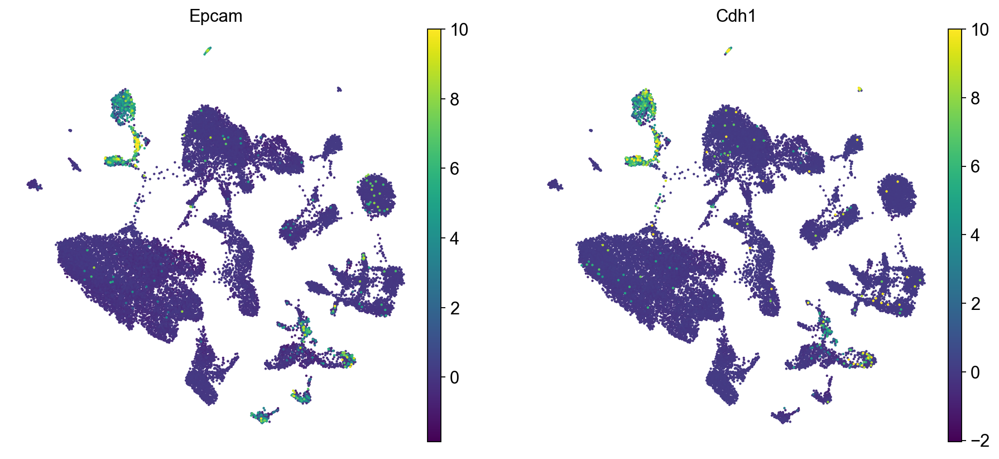

T-Cells


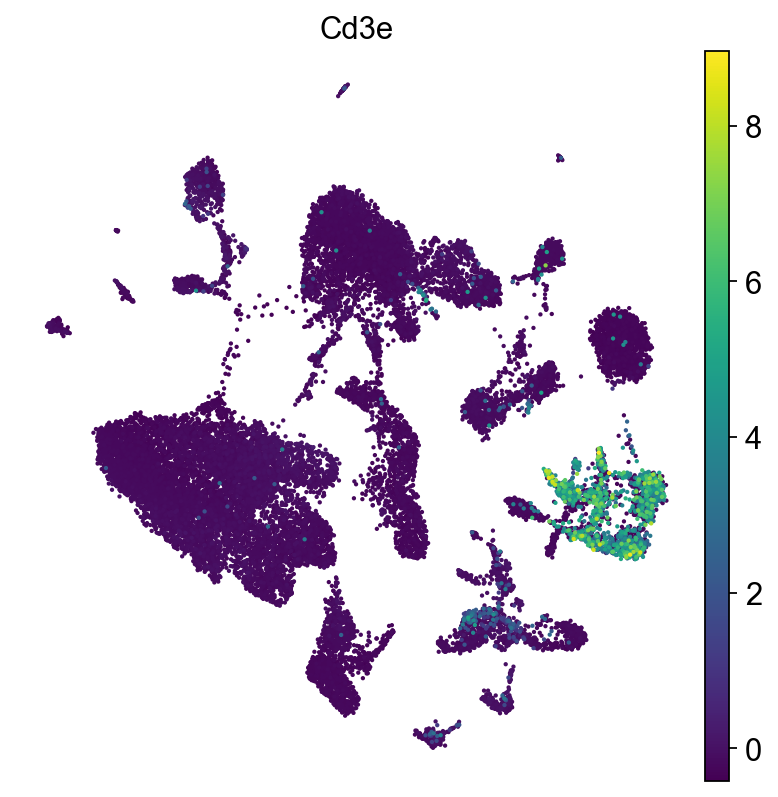

B-Cells


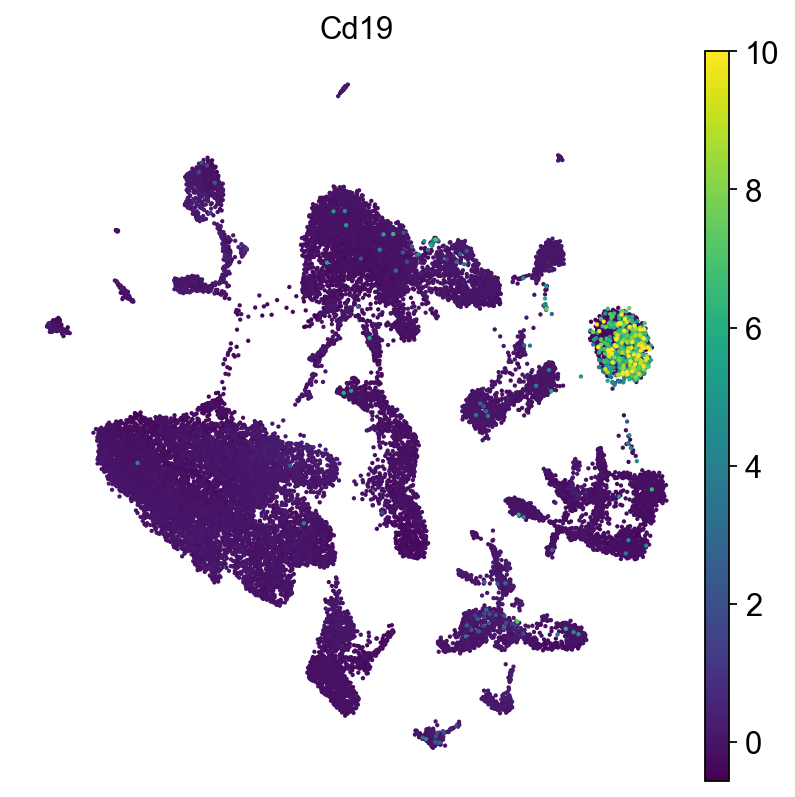

Myeloid and macrophage


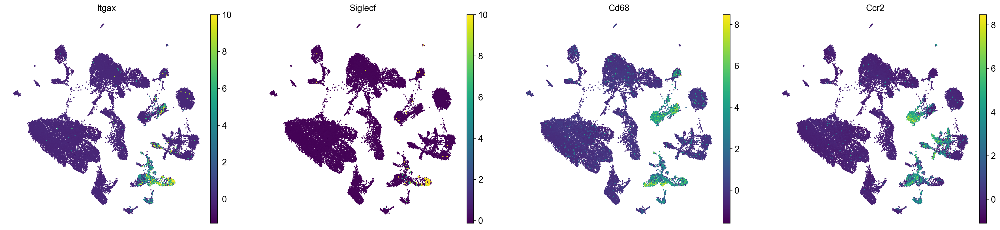

Neutrophil


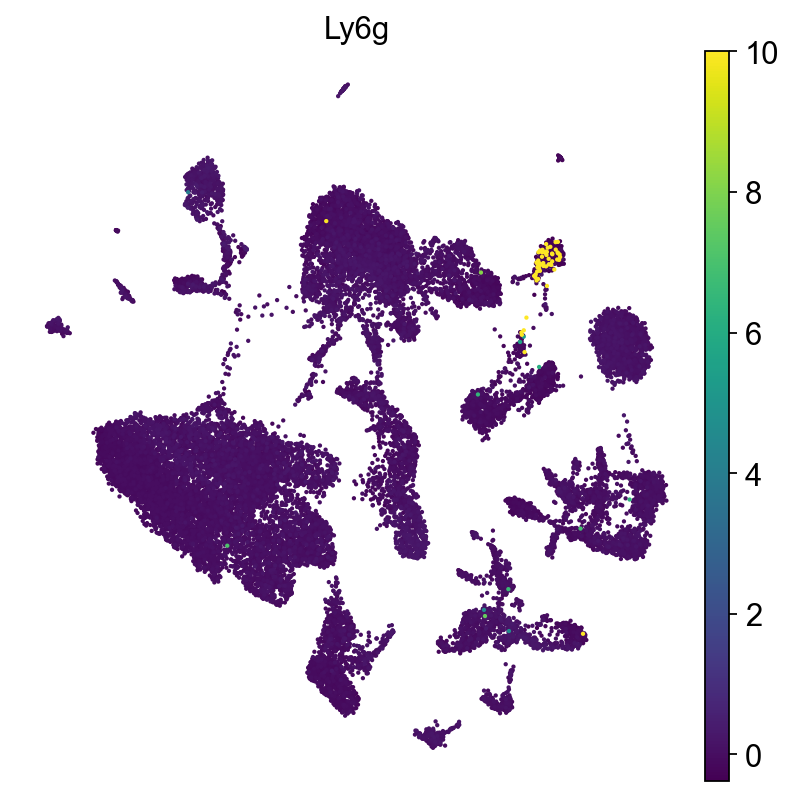

Mesothelial


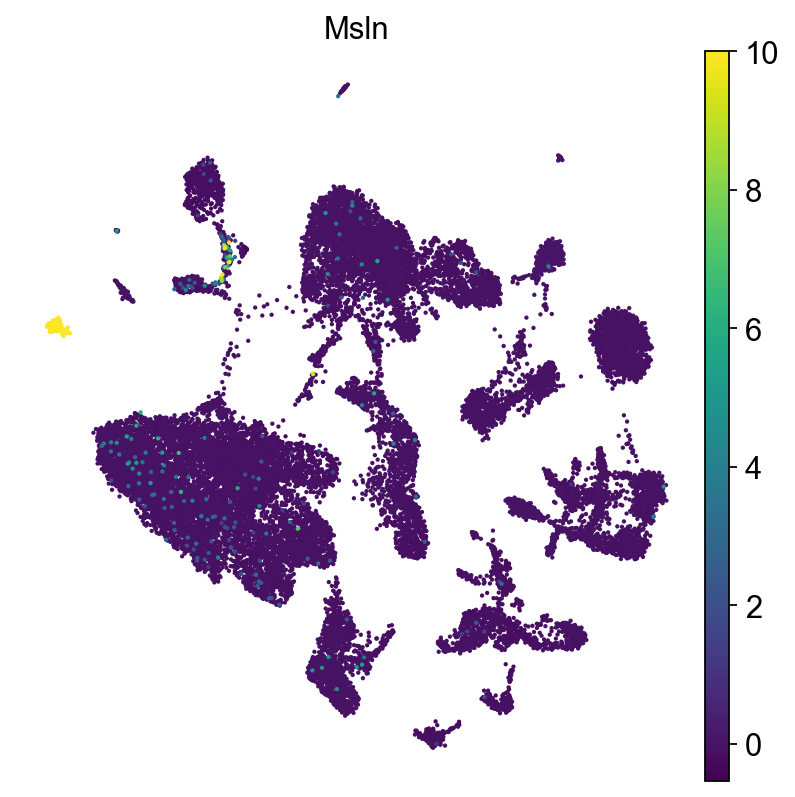

Dendritic-Cells


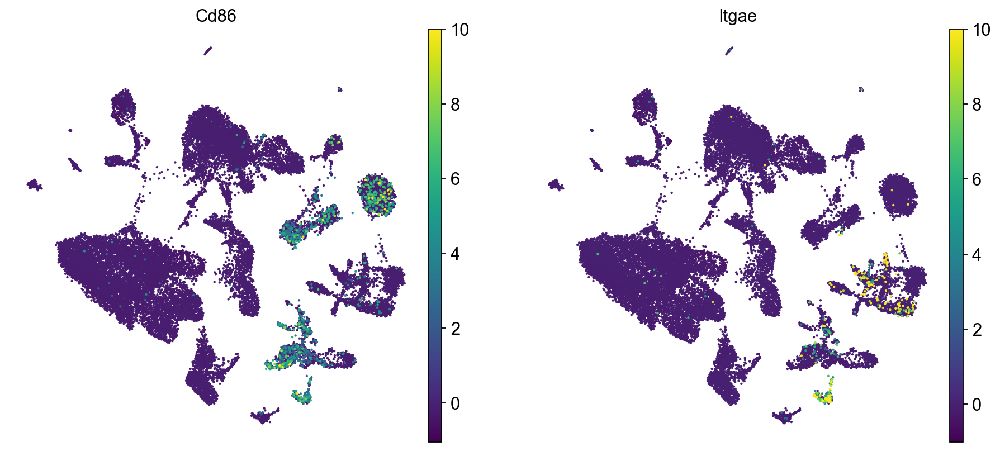

NK-Cells


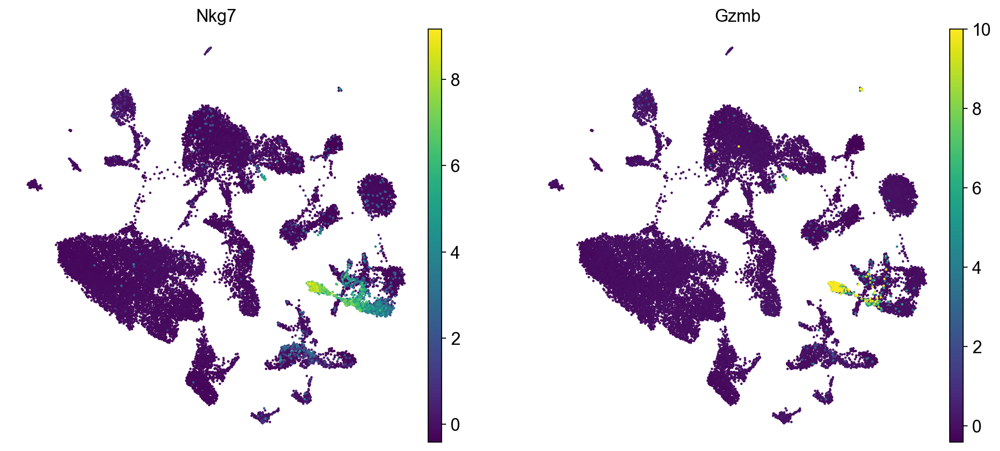

Mesenchymal


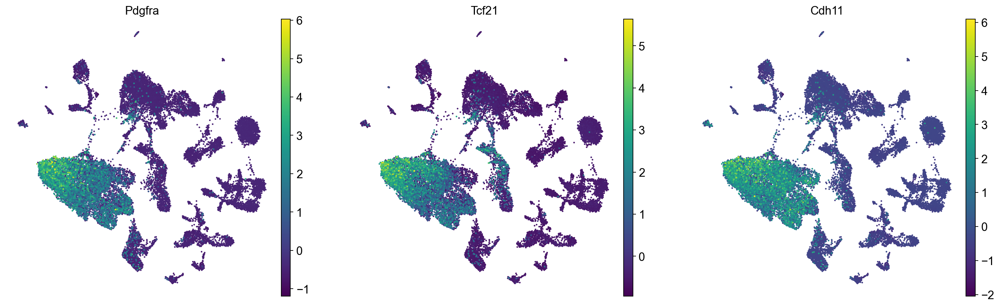

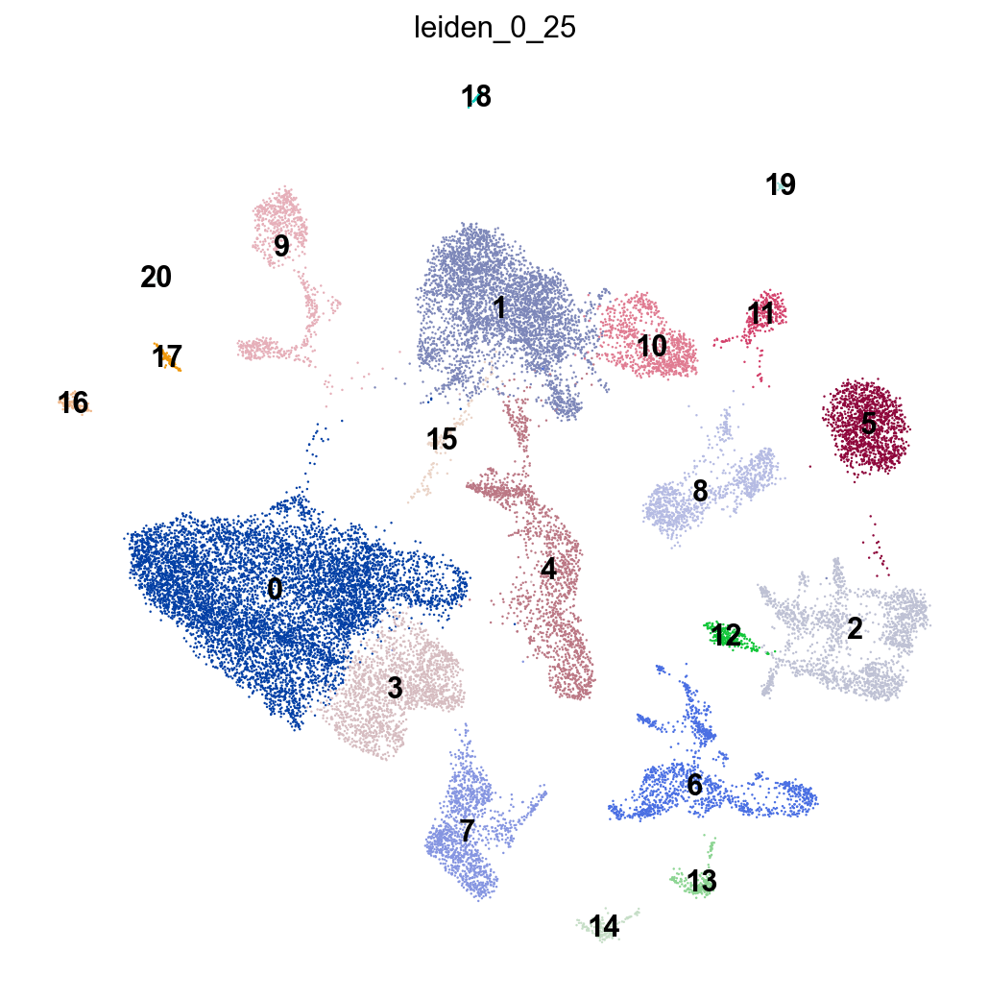

In [55]:
#with plt.rc_context({"figure.figsize": (10, 10), "figure.dpi": (300)}):
# Tsukui Markers
plt.rcParams['figure.figsize'] = (6, 6)
for cell_type in markers_tsukui.keys():
    print(cell_type)
    sc.pl.umap(adata, color=markers_tsukui[cell_type], size=15)
sc.tl.leiden(adata, resolution=0.25, key_added="leiden_0_25")
plt.rcParams['figure.figsize'] = (8, 8)
sc.pl.umap(adata, color="leiden_0_25", legend_loc="on data")

Macrophages


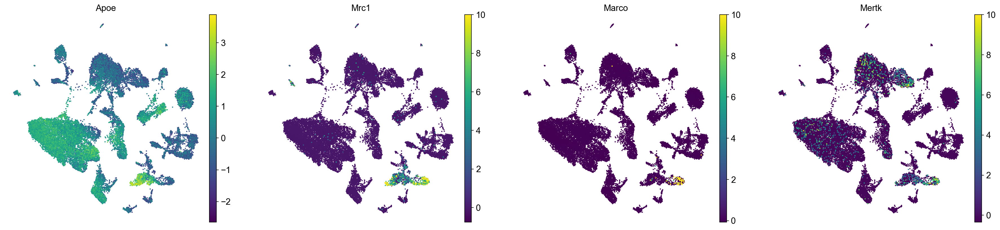

Monocytes


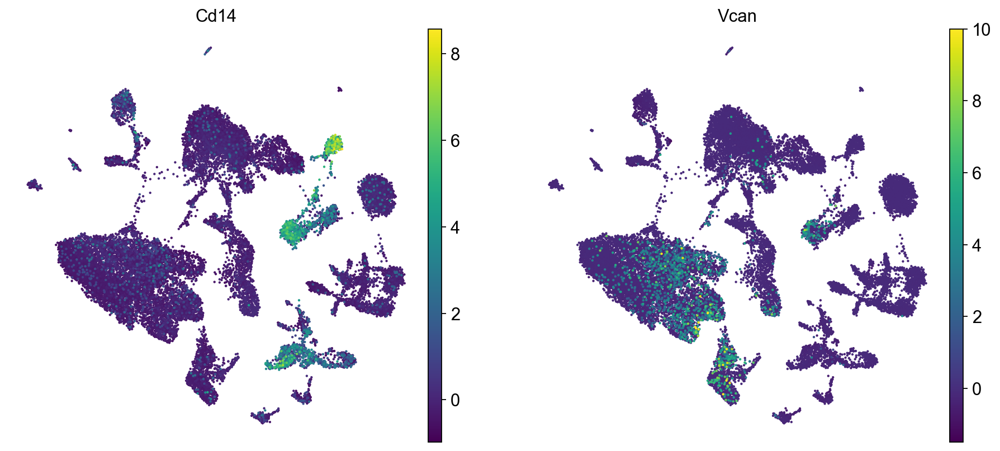

T-Cells


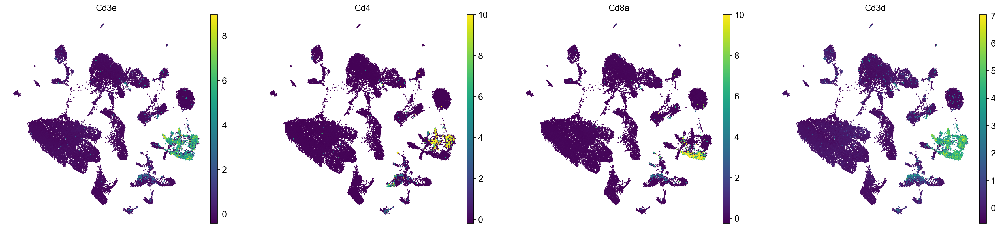

B-Cells


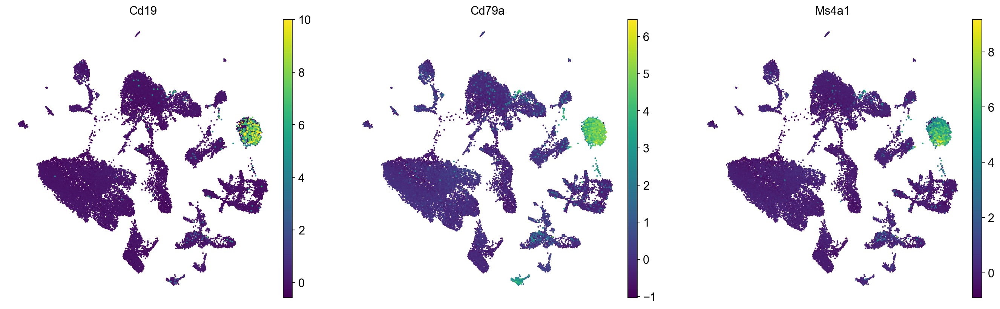

AT2


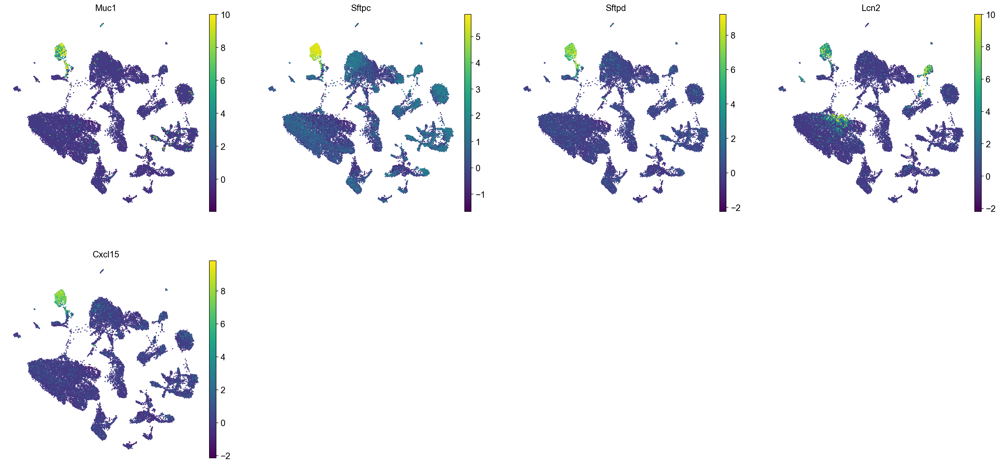

AT1


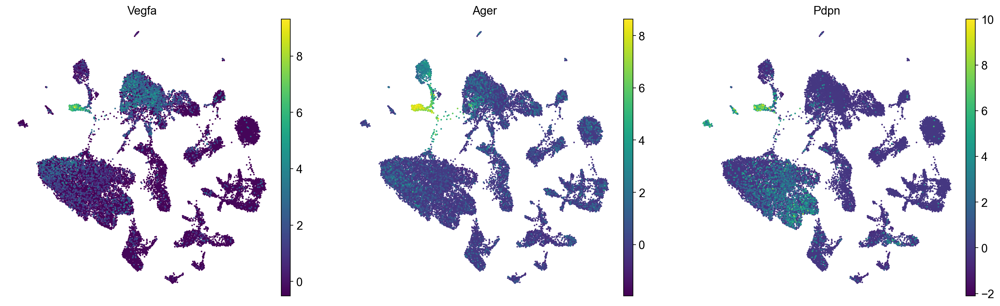

Krt8


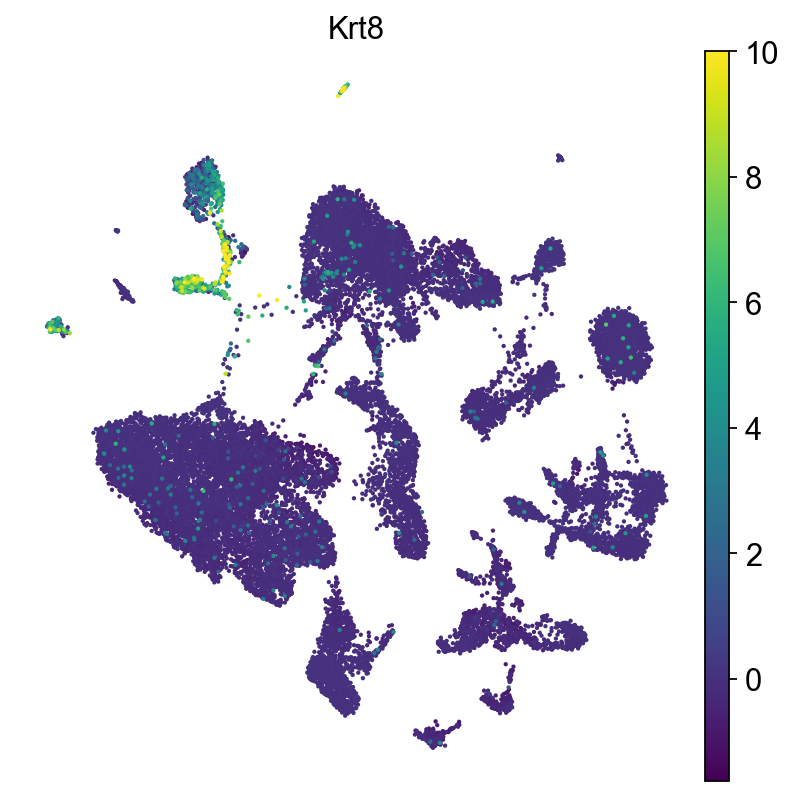

Endothelial


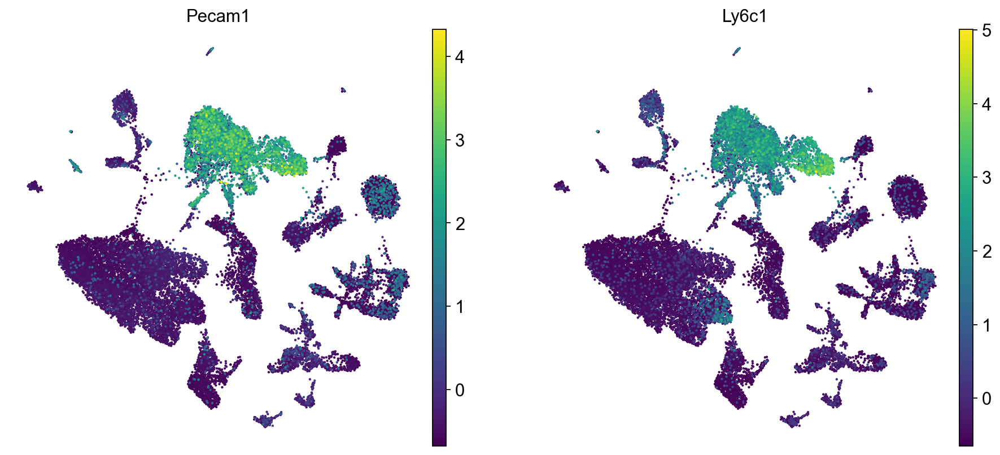

Fibroblasts


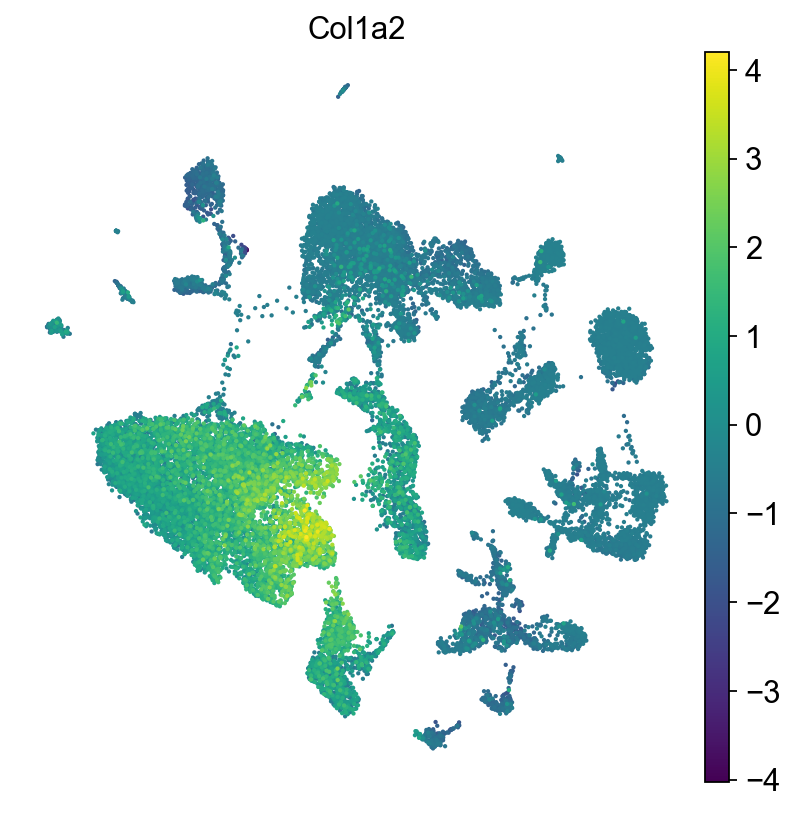

Myofibroblasts


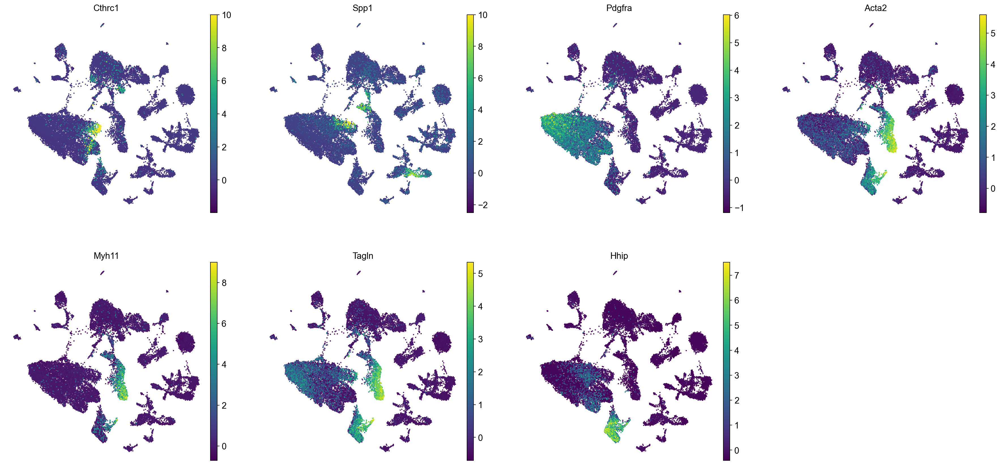

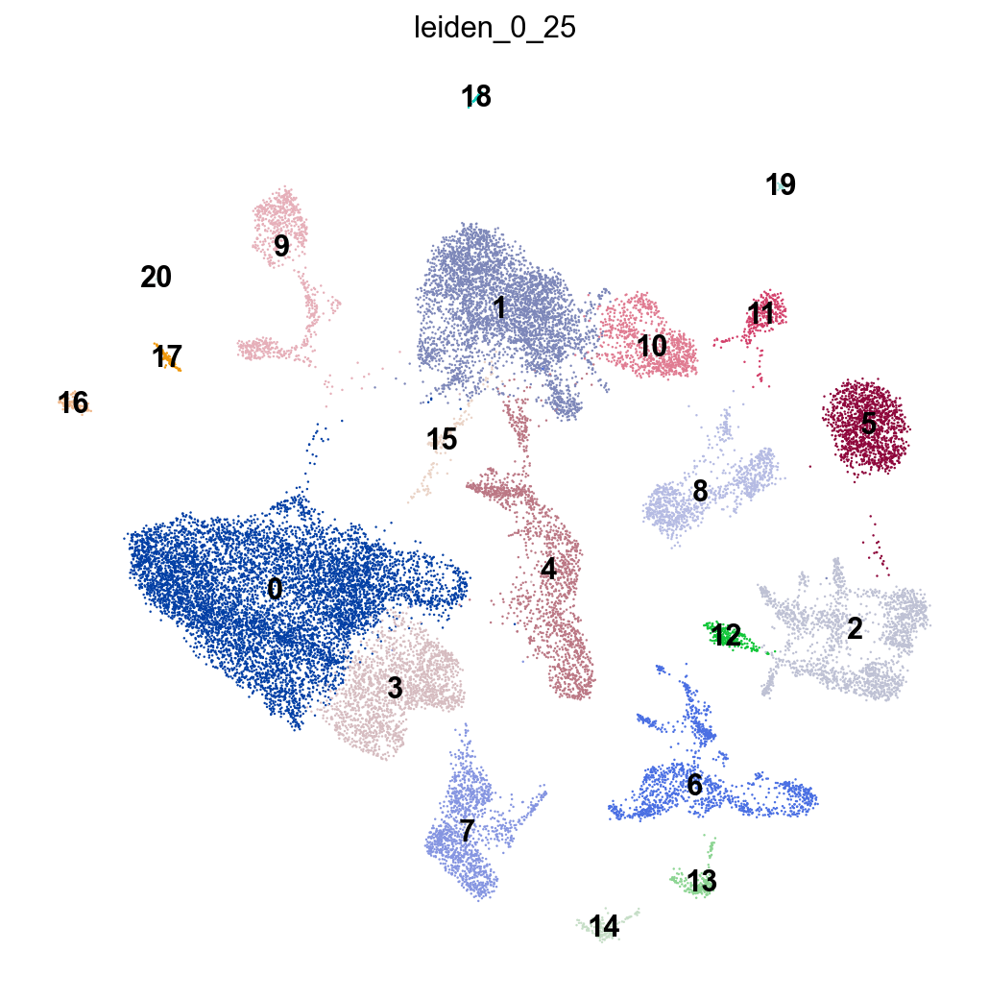

In [56]:
#with plt.rc_context({"figure.figsize": (10, 10), "figure.dpi": (300)}):
plt.rcParams['figure.figsize'] = (6, 6)
for cell_type in marker_genes.keys():
    print(cell_type)
    sc.pl.umap(adata, color=marker_genes[cell_type], size=15)
sc.tl.leiden(adata, resolution=0.25, key_added="leiden_0_25")
plt.rcParams['figure.figsize'] = (8, 8)
sc.pl.umap(adata, color="leiden_0_25", legend_loc="on data")

In [ ]:
sc.do